# Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Write your Algorithm
* [Step 6](#step6): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Make sure that you've downloaded the required human and dog datasets:

**Note: if you are using the Udacity workspace, you *DO NOT* need to re-download these - they can be found in the `/data` folder as noted in the cell below.**

* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dog_images`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home directory, at location `/lfw`.  

*Note: If you are using a Windows machine, you are encouraged to use [7zip](http://www.7-zip.org/) to extract the folder.*

In the code cell below, we save the file paths for both the human (LFW) dataset and dog dataset in the numpy arrays `human_files` and `dog_files`.

In [1]:
import numpy as np
from glob import glob

# load filenames for human and dog images
human_files = np.array(glob("/data/lfw/*/*"))
dog_files = np.array(glob("/data/dog_images/*/*/*"))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


### Data Exploration and Visualization

In [109]:
#Explore Dog Training Data Statistics
import matplotlib.pyplot as plt
from collections import OrderedDict
import pandas as pd
import cv2     

dog_type_count = OrderedDict()

#Store count of each category
for img in range(len(dog_files)):
    name = dog_files[img]
    dog_type = name[name.find(".") + 1: name.rfind("/")]
    if (dog_type in dog_type_count.keys()) == False:  
        dog_type_count[dog_type] = 0
        #print(dog_type, "added to list.")
    else:
        dog_type_count[dog_type] = dog_type_count[dog_type] + 1
        #print("added one more ",dog_type)
        
dog_type_count_ordered = OrderedDict(sorted(dog_type_count.items(), key=lambda x: x[1], reverse = True))

print("{}\t{:<40}\t{}".format("#","Dog Type", "Count"))
count = 0 
for key in dog_type_count_ordered:
    print("{}\t{:<40}\t{}".format(count,key, dog_type_count_ordered[key]))
    count += 1


#	Dog Type                                	Count
0	Alaskan_malamute                        	95
1	Border_collie                           	92
2	Basset_hound                            	91
3	Dalmatian                               	88
4	Bull_terrier                            	86
5	Bullmastiff                             	85
6	Basenji                                 	85
7	Cavalier_king_charles_spaniel           	83
8	Australian_cattle_dog                   	82
9	Australian_shepherd                     	82
10	Irish_terrier                           	81
11	Dachshund                               	81
12	American_staffordshire_terrier          	81
13	Boston_terrier                          	80
14	Bernese_mountain_dog                    	80
15	Briard                                  	80
16	Boxer                                   	79
17	Golden_retriever                        	79
18	Belgian_sheepdog                        	79
19	American_eskimo_dog                     	79
20	Cane_corso        

In [105]:
# Explore human face data statistics
human_type_count = OrderedDict()

#Store count of each category
for img in range(len(human_files)):
    name = human_files[img]
    human_type = name[name.find("lfw/") + 4: name.rfind("/")]
    if (human_type in human_type_count.keys()) == False:  
        human_type_count[human_type] = 0
        #print(dog_type, "added to list.")
    else:
        human_type_count[human_type] = human_type_count[human_type] + 1
        #print("added one more ",dog_type)
        
human_type_count_ordered = OrderedDict(sorted(human_type_count.items(), key=lambda x: x[1], reverse = True))

print("{}\t{:<40}\t{}".format("#","Human Type", "Count"))
count = 0 
for key in human_type_count_ordered:
    print("{}\t{:<40}\t{}".format(count,key, human_type_count_ordered[key]))
    count += 1

#	Human Type                              	Count
0	George_W_Bush                           	529
1	Colin_Powell                            	235
2	Tony_Blair                              	143
3	Donald_Rumsfeld                         	120
4	Gerhard_Schroeder                       	108
5	Ariel_Sharon                            	76
6	Hugo_Chavez                             	70
7	Junichiro_Koizumi                       	59
8	Jean_Chretien                           	54
9	John_Ashcroft                           	52
10	Serena_Williams                         	51
11	Jacques_Chirac                          	51
12	Vladimir_Putin                          	48
13	Luiz_Inacio_Lula_da_Silva               	47
14	Gloria_Macapagal_Arroyo                 	43
15	Arnold_Schwarzenegger                   	41
16	Jennifer_Capriati                       	41
17	Laura_Bush                              	40
18	Lleyton_Hewitt                          	40
19	Hans_Blix                               	38
20	Alejandro_Tol

1237	Nancy_Reagan                            	1
1238	Sue_Wicks                               	1
1239	Bobby_Robson                            	1
1240	Kiki_Vandeweghe                         	1
1241	Luiz_Felipe_Scolari                     	1
1242	Brendan_Hansen                          	1
1243	Joerg_Haider                            	1
1244	John_Rowland                            	1
1245	Garry_Trudeau                           	1
1246	Tom_Jones                               	1
1247	Jessica_Alba                            	1
1248	Jean-Claude_Juncker                     	1
1249	Lisa_Gottsegen                          	1
1250	Cathy_Freeman                           	1
1251	Leslie_Moonves                          	1
1252	Christine_Ebersole                      	1
1253	Lindsay_Benko                           	1
1254	Suzanne_Gaudet                          	1
1255	Mack_Brown                              	1
1256	Anneli_Jaatteenmaki                     	1
1257	Magui_Serna                        

2810	Tracee_Treadwell                        	0
2811	Ryan_Leaf                               	0
2812	Anne_Heche                              	0
2813	Viara_Vike-Freiberga                    	0
2814	Stephane_Rousseau                       	0
2815	Patrick_Coleman                         	0
2816	Anthony_Pico                            	0
2817	Nicole_Parker                           	0
2818	Eduardo_Romero                          	0
2819	Paula_Abdul                             	0
2820	Mstislav_Rostropovich                   	0
2821	Himmler_Rebu                            	0
2822	David_Alpay                             	0
2823	Randall_Tobias                          	0
2824	Irwan_Fadzi_Idris                       	0
2825	Kyle_Shewfelt                           	0
2826	Noel_Niell                              	0
2827	Kathryn_Grayson                         	0
2828	Judy_Dean                               	0
2829	Richard_Cohen                           	0
2830	Sharess_Harrell                    

4066	Brad_Russ                               	0
4067	Carol_Niedermayer                       	0
4068	Vojislav_Seselj                         	0
4069	George_Blaney                           	0
4070	John_Prescott                           	0
4071	Angel_Maza                              	0
4072	Chan_Choi                               	0
4073	Grace_Brinell                           	0
4074	Baburam_Bhattari                        	0
4075	Dave_Ragone                             	0
4076	Kelly_Osbourne                          	0
4077	Henning_Scherf                          	0
4078	David_Brinkley                          	0
4079	Sidney_Kimmel                           	0
4080	Mike_Webster                            	0
4081	Brian_Cashman                           	0
4082	Elmar_Brok                              	0
4083	Dale_Bosworth                           	0
4084	Vadim_Devyatovskiy                      	0
4085	Joxel_Garcia                            	0
4086	David_Brown                        

5058	Kristen_Rivera                          	0
5059	Suzanne_Torrance                        	0
5060	Frank_Beamer                            	0
5061	Chang_Saio-yue                          	0
5062	Eddie_Lewis                             	0
5063	Mitchell_Garabedian                     	0
5064	James_Brosnahan                         	0
5065	Angelica_Romero                         	0
5066	Donnie_Brennan                          	0
5067	Mario_Gallegos                          	0
5068	Raul_Cubas                              	0
5069	Mark_Butcher                            	0
5070	Freda_Black                             	0
5071	Alfredo_Moreno                          	0
5072	Jacques_Villeneuve                      	0
5073	Jerry_Sloan                             	0
5074	Jeremy_Gompertz                         	0
5075	Perry_Farrell                           	0
5076	Helen_Alvare                            	0
5077	Michael_Richards                        	0
5078	Phil_Cullen                        

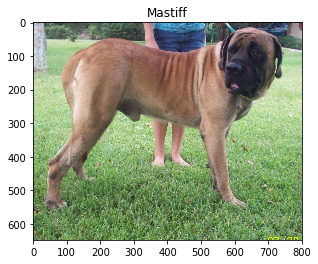

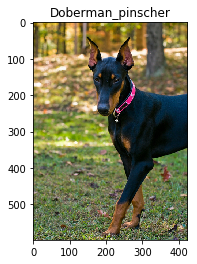

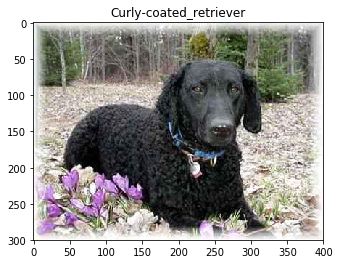

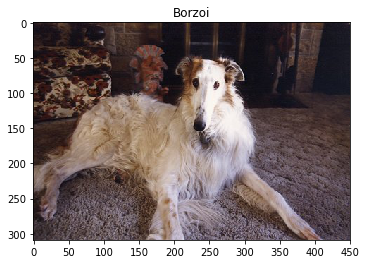

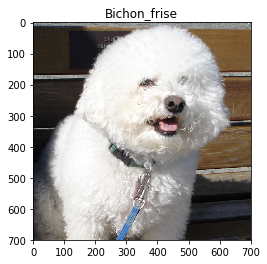

...

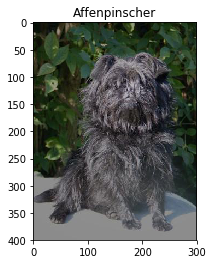

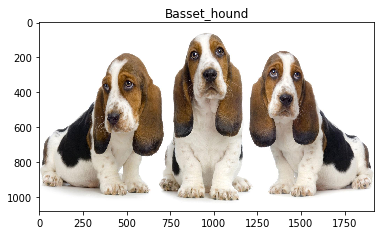

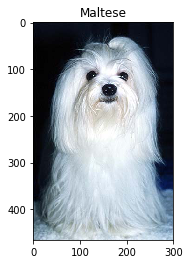

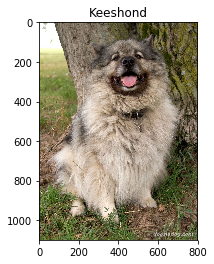

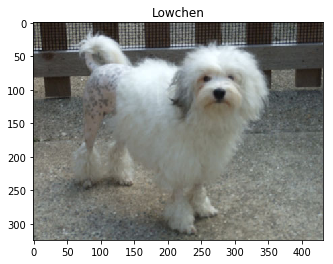

In [114]:
#Visualize Sample Dog Images
dog_type_tracker = {}

#Store count of each category
for img in range(len(dog_files)):
    name = dog_files[img]
    dog_type = name[name.find(".") + 1: name.rfind("/")]
    if (dog_type in dog_type_tracker.keys()) == False:  
        dog_type_tracker[dog_type] = 1
        image =  cv2.cvtColor(cv2.imread(dog_files[img]), cv2.COLOR_BGR2RGB)
        plt.title(dog_type)
        plt.imshow(image)
        plt.show()
        

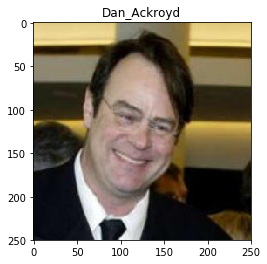

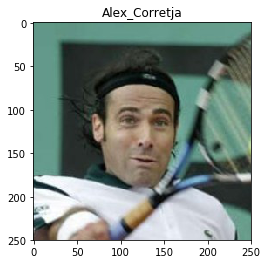

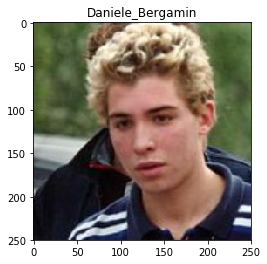

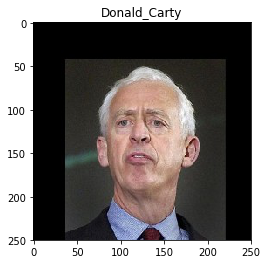

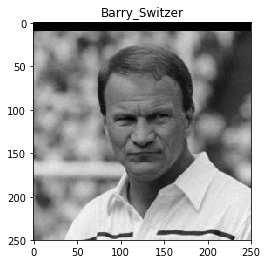

...

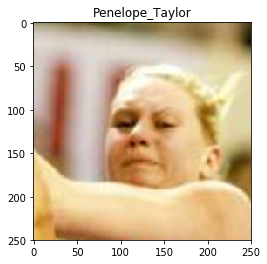

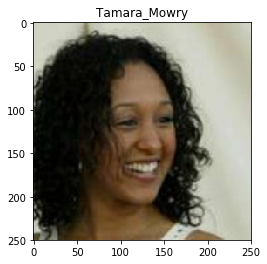

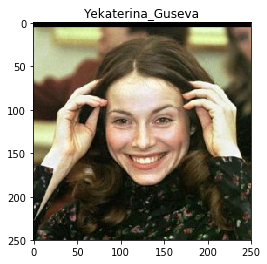

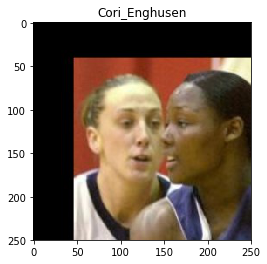

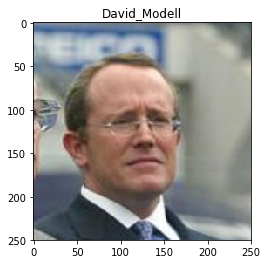

In [ ]:
#Visualize Sample Human Images
human_type_tracker = {}

#Store count of each category
for img in range(len(human_files)):
    name = human_files[img]
    human_type = name[name.find("lfw/") + 4: name.rfind("/")]
    if (human_type in human_type_tracker.keys()) == False:  
        human_type_tracker[human_type] = 1
        image =  cv2.cvtColor(cv2.imread(human_files[img]), cv2.COLOR_BGR2RGB)
        plt.title(human_type)
        plt.imshow(image)
        plt.show()

<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.  In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


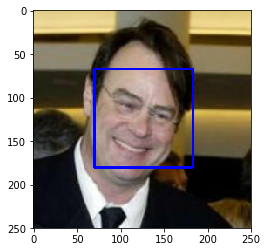

In [2]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[0])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [3]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 

The human face classifier correctly identified human faces in 98% of human images. However, it incorrectly identified 17% of dog images as containing human faces. 

In [4]:
from tqdm import tqdm

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

#-#-# Do NOT modify the code above this line. #-#-#

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.

#set up counter to track number of human faces found in human and dog image file
human_count = 0
dog_count = 0

#loop through human images
for img in human_files_short:
    if face_detector(img) == True:
        human_count += 1
        
#loop through dog images
for img in dog_files_short: 
    if face_detector(img):
        dog_count += 1
        
print("In human images, correctly identified ", human_count, " out of 100 images.")
print("In dog images, incorrectly identified human faces in", dog_count, " out of 100 images.")

In human images, correctly identified  98  out of 100 images.
In dog images, incorrectly identified human faces in 17  out of 100 images.


We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [5]:
### (Optional) 
### TODO: Test performance of anotherface detection algorithm.
### Feel free to use as many code cells as needed.


---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  

In [6]:
import torch
import torchvision.models as models

# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.torch/models/vgg16-397923af.pth
100%|██████████| 553433881/553433881 [00:05<00:00, 105773829.49it/s]


Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model

In the next code cell, you will write a function that accepts a path to an image (such as `'dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg'`) as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output should always be an integer between 0 and 999, inclusive.

Before writing the function, make sure that you take the time to learn  how to appropriately pre-process tensors for pre-trained models in the [PyTorch documentation](http://pytorch.org/docs/stable/torchvision/models.html).

In [7]:
from PIL import Image, ImageFile
import torchvision.transforms as transforms
ImageFile.LOAD_TRUNCATED_IMAGES = True 

def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## TODO: Complete the function.
    
    # convert image to RBG
    img = Image.open(img_path).convert('RGB')
    # define image normalization (from PyTorch documentation)
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
    #define and combine image pre-processing/transformation steps (resize --> tensor --> normalize)
    preprocess = transforms.Compose([transforms.Resize(size = (224,224)), 
                                     transforms.ToTensor(),
                                     normalize])
    
    #apply preprocessing to each image
    img_transformed = preprocess(img)[:3,:,:].unsqueeze(0)
    
    # move GPU if it's available
    if use_cuda:
        img_transformed = img_transformed.cuda()
   
    # apply VGG-16 to transformed image to make prediction
    output = VGG16(img_transformed)
    # find maximum likelihood prediction
    prediction = torch.argmax(output).item()
                                     
    return prediction # predicted class index

In [8]:
#test VGG model
predict_dog_image = VGG16_predict(dog_files_short[0])
print("Dog image prediction index: ", predict_dog_image)

predict_human_image = VGG16_predict(human_files_short[2])
print("Human image prediction index: ", predict_human_image)

Dog image prediction index:  243
Human image prediction index:  400


### (IMPLEMENTATION) Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

Use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [9]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    ## TODO: Complete the function.
    prediction = VGG16_predict(img_path)
    if prediction >= 151 and prediction <= 268:
        return True
    else:
        return False # true/false

### (IMPLEMENTATION) Assess the Dog Detector

__Question 2:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 

The pre-trained VGG-16 model is 100% accurate in predicting dog faces from dog images and 100% accurate in predicting no dog faces in human images (i.e., 0 dogs detected in human image)

In [10]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.

#set up counter to track number of dog faces found in human and dog image file
human_count = 0
dog_count = 0

#loop through human images
for img in human_files_short:
    if dog_detector(img) == True:
        human_count += 1
        
#loop through dog images
for img in dog_files_short: 
    if dog_detector(img) == True:
        dog_count += 1
        
print("In human images, incorrectly identified dog faces in ", human_count, " out of 100 images.")
print("In dog images, correctly identified dog faces in", dog_count, " out of 100 images.")

In human images, incorrectly identified dog faces in  0  out of 100 images.
In dog images, correctly identified dog faces in 100  out of 100 images.


We suggest VGG-16 as a potential network to detect dog images in your algorithm, but you are free to explore other pre-trained networks (such as [Inception-v3](http://pytorch.org/docs/master/torchvision/models.html#inception-v3), [ResNet-50](http://pytorch.org/docs/master/torchvision/models.html#id3), etc).  Please use the code cell below to test other pre-trained PyTorch models.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [11]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 10%.  In Step 4 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have trouble distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dog_images/train`, `dog_images/valid`, and `dog_images/test`, respectively).  You may find [this documentation on custom datasets](http://pytorch.org/docs/stable/torchvision/datasets.html) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [12]:
import os
from torchvision import datasets

### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

batch_size = 20
num_workers = 0

data_dir = '/data/dog_images/'

#Define paths for train, validation and test data
train_path = data_dir + 'train'
val_path = data_dir + 'valid'
test_path = data_dir + 'test'

#Normalization parameters, from above
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

#Define tranformation process for training and validation data
training_data_transformation = transforms.Compose([transforms.RandomResizedCrop(224), #randomly crop and resize to 224x224 
            transforms.RandomHorizontalFlip(), #randomly flip images horizontally
            transforms.RandomRotation(15), #randomly rotate images
            transforms.ToTensor(),
            normalize])

validation_and_test_data_transformation = transforms.Compose([transforms.Resize(size = (224,224)), # resize to 224x224 
            transforms.ToTensor(),
            normalize])

#Process training, validation and testing data
train_dataset = datasets.ImageFolder(train_path, transform = training_data_transformation)
validation_dataset = datasets.ImageFolder(val_path, transform = validation_and_test_data_transformation)
test_dataset = datasets.ImageFolder(test_path, transform = validation_and_test_data_transformation)

# Set up dataloaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size= batch_size, num_workers = num_workers, shuffle = True)
validation_loader = torch.utils.data.DataLoader(validation_dataset, batch_size= batch_size, num_workers = num_workers)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size= batch_size, num_workers = num_workers)

# Create set holding the loaders
loaders_scratch = {
    'train': train_loader,
    'valid': validation_loader,
    'test': test_loader
}

**Question 3:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?


**Answer**:

I have decided to transform the images based on the following pipeline:
1) Randomly crop and reesize training images to 224 x 224 - this allows us to deal with occlusions and partial images, and standardizes our final input training images to 224x224 
2) Randomly horizontally flip and rotate training images - this serves as data augmentation and lets us deal with different positions and angles. 
3) Normalize the training data - this helps the CNN perform better

For the validation and testing data, I did not apply image augmentation (e.g., cropping, flipping, rotating) since this data isn't use to train the model. Instead, I only apply the resizing (to 224x224) and image normalization steps so the validation/test data fits the specification of our model. 

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  Use the template in the code cell below.

In [13]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self):
        super(Net, self).__init__()
        ## Define layers of a CNN
        # 1st convolution layer (3 --> 36 channels; 3x3 kernel with 1 padding and 1 stride by default)
        self.conv1 = nn.Conv2d(3, 36, 3, padding = 1)
        # 2nd convolution layer (36 --> 64 channels; 3x3 kernel with 1 padding and 1 stride by default)
        self.conv2 = nn.Conv2d(36, 64, 3, padding = 1)
        # 3rd convolution layer (36 --> 64 channels; 3x3 kernel with 1 padding and 1 stride by default)
        self.conv3 = nn.Conv2d(64, 128, 3, padding = 1)
        
        # Define max pooling layer (kernel = 2x2, stride = 2); will downsize images by factor of 2
        self.pool = nn.MaxPool2d(2,2)
        
        #Define fully connected layers
        # 1st FC layer (28 * 28 * 128 --> 512); image is 28x28 after 3 rounds of max pooling (i.e., diving 224 by 2^3)
        self.fc1 = nn.Linear(28 * 28 * 128, 512)
        # 2nd FC layer (512 --> 133); output classification has 133 dog categories
        self.fc2 = nn.Linear(512, 133)
        
        # Define dropout layer (p = 0.25)
        self.drop = nn.Dropout(0.25)
        
        # Define Batch Normalization step to address internal covariate shift after each mini-batch, enabling us to increase learning rate and be less careful with initialization
        self.batch_norm = nn.BatchNorm1d(512) #applied after first FC
    
    def forward(self, x):
        ## Define forward behavior
        # Three CNN layers with relu and max pooling after each layer
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        
        # Reshape (flatten) tensor to 28 * 28 * 512 (with n row) for input into fully connected layer
        x = x.view(-1, 28 * 28 * 128)
        
        # Fully connected layers with dropout inbetween
        # First FC, followed by batch normalization and relu activation
        x = F.relu(self.batch_norm(self.fc1(x)))
        # Dropout layer
        x = self.drop(x)
        # Second FC, without relu activation
        x = F.relu(self.fc2(x))
        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

In [14]:
#print model architecture
print(model_scratch)

Net(
  (conv1): Conv2d(3, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(36, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=100352, out_features=512, bias=True)
  (fc2): Linear(in_features=512, out_features=133, bias=True)
  (drop): Dropout(p=0.25)
  (batch_norm): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)


__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__ 

My final CNN architecture - as printed above -  is structured as follows:
- **Preprocessing step**: Resize (to 224x224) and augment images as outlined in question 3. I choose 224x224 as this is the typical size for models such as VGG-16.
- **Convolution Layers**: Three convolution layers, followed by relu activation and max pooling. All kernel size is 3x3, stride is 1 and padding is 1. This means the image size decreases by a magnitude of 2 with each convolutional layer. We increase depth with each convolutional layer.
    - **CVN Layer 1**: 3 input channels (for RGB) --> 36 output channels
    - **CVN Layer 2**: 36 input channels --> 64 output channels
    - **CVN Layer 3**: 64 input channels --> 128 output channels
- **Fully Connected Layers**: Two fully connected layers with relu activation and a dropout layer in between
    - **FC Layer 1**: Takes flattened output from CVN layers; 28 * 28 * 128 features input (based on image size + channel of last CVN) --> 512 features output
    - **Dropout Layer**: Dropout layer with p = 0.25 to prevent overfitting
    - **FC Layer 2**: Takes output from layer 1 and outputs 133 features for the 133 dog breed classes.


### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and the optimizer as `optimizer_scratch` below.

In [15]:
import torch.optim as optim

### TODO: select loss function
criterion_scratch = nn.CrossEntropyLoss() #cross entrophy for multi-class

### TODO: select optimizer
optimizer_scratch = optim.SGD(model_scratch.parameters(), lr=0.1) #Stocastic Gradient Descent (could use Adam too)

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_scratch.pt'`.

In [16]:
def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss to infinity
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train() #training mode
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## find the loss and update the model parameters accordingly
            ## record the average training loss, using something like train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
            # clear gradient at start of each pass (we're doing CNN, not RNN)
            optimizer.zero_grad()
            # forward pass on each batch of data
            output = model(data) 
            # calculate loss after each forward pass
            loss = criterion(output, target) #target = ground truth labels
            # backward pass based on loss (error) to get gradients for each parameter/node
            loss.backward()
            # use optimizer to iterate over all parameters/nodes using their gradients 
            optimizer.step()
            # calculate training loss (formula provided above)
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
        ######################    
        # validate the model #
        ######################
        model.eval() #evaluation mode
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            # update the average validation loss
            # apply model to validation data bach
            output = model(data) 
            # calculate loss of each batch
            loss = criterion(output, target) #target = ground truth labels
            # calculate average loss of batch
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (loss.data - valid_loss))

            
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
        
        ## TODO: save the model if validation loss has decreased
        if valid_loss < valid_loss_min:
            print('Validation loss decreased from {:.6f} to {:.6f}. Saving model'.format(valid_loss_min, valid_loss))
            torch.save(model.state_dict(), save_path) #save model to provided save path
            valid_loss_min = valid_loss #update minimum validation loss
            
    # return trained model
    return model


In [17]:
## Train the model 
# train the model, reduce epoch to 10 for time saving purposes
model_scratch = train(20, loaders_scratch, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'model_scratch.pt')

# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

Epoch: 1 	Training Loss: 4.817167 	Validation Loss: 4.858711
Validation loss decreased from inf to 4.858711. Saving model
Epoch: 2 	Training Loss: 4.712834 	Validation Loss: 4.622993
Validation loss decreased from 4.858711 to 4.622993. Saving model
Epoch: 3 	Training Loss: 4.638778 	Validation Loss: 4.619544
Validation loss decreased from 4.622993 to 4.619544. Saving model
Epoch: 4 	Training Loss: 4.584772 	Validation Loss: 4.478432
Validation loss decreased from 4.619544 to 4.478432. Saving model
Epoch: 5 	Training Loss: 4.517636 	Validation Loss: 4.436772
Validation loss decreased from 4.478432 to 4.436772. Saving model
Epoch: 6 	Training Loss: 4.494678 	Validation Loss: 4.423419
Validation loss decreased from 4.436772 to 4.423419. Saving model
Epoch: 7 	Training Loss: 4.455785 	Validation Loss: 4.378767
Validation loss decreased from 4.423419 to 4.378767. Saving model
Epoch: 8 	Training Loss: 4.387727 	Validation Loss: 4.389700
Epoch: 9 	Training Loss: 4.358684 	Validation Loss: 4.2

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images.  Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 10%.

In [18]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    #Iterate through test dataset
    model.eval() #put model in evaluation mode
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

# call test function    
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 3.992676


Test Accuracy: 14% (118/836)


---
<a id='step4'></a>
## Step 4: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively). 

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [19]:
## TODO: Specify data loaders
# Use the same loader as the model trained from scratch
loaders_transfer_learning = loaders_scratch.copy()

### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify dog breed.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [31]:
import torchvision.models as models
import torch.nn as nn

## TODO: Specify model architecture 
# load pre-trained inception net
model_transfer = models.resnet101(pretrained=True)

if use_cuda:
    model_transfer = model_transfer.cuda()

Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.torch/models/resnet101-5d3b4d8f.pth
100%|██████████| 178728960/178728960 [00:01<00:00, 100675882.11it/s]


In [32]:
#Print model to examine architecture
print(model_transfer)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [33]:
# Define frozen vs training layers
for param in model_transfer.parameters():
    param.requires_grad = False
    
model_transfer.fc = nn.Linear(2048, 133, bias=True)

if use_cuda:
    model_transfer = model_transfer.cuda()

__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 

I used the existing resnet101 architecture with pre-trained weights from the ImageNeet dataset. I choose the resnet101 for its high accuracy at image classification tasks.

To apply it to this problem, I retrained the last Fully Connected Layer and changed the output to 133 features, rather than the original 1,000 features.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/master/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/master/optim.html).  Save the chosen loss function as `criterion_transfer`, and the optimizer as `optimizer_transfer` below.

In [34]:
#use same loss - cross-entrophy 
criterion_transfer = nn.CrossEntropyLoss()
#use same optimizer - stocastic gradient descent
optimizer_transfer = optim.SGD(model_transfer.fc.parameters(), lr=0.05)

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

In [35]:
# train the model
model_transfer = train(10, loaders_transfer_learning, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')

# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

Epoch: 1 	Training Loss: 2.807072 	Validation Loss: 1.084800
Validation loss decreased from inf to 1.084800. Saving model
Epoch: 2 	Training Loss: 1.479474 	Validation Loss: 0.714565
Validation loss decreased from 1.084800 to 0.714565. Saving model
Epoch: 3 	Training Loss: 1.218199 	Validation Loss: 0.633089
Validation loss decreased from 0.714565 to 0.633089. Saving model
Epoch: 4 	Training Loss: 1.117560 	Validation Loss: 0.595598
Validation loss decreased from 0.633089 to 0.595598. Saving model
Epoch: 5 	Training Loss: 1.023199 	Validation Loss: 0.543974
Validation loss decreased from 0.595598 to 0.543974. Saving model
Epoch: 6 	Training Loss: 0.982977 	Validation Loss: 0.566429
Epoch: 7 	Training Loss: 0.976695 	Validation Loss: 0.488645
Validation loss decreased from 0.543974 to 0.488645. Saving model
Epoch: 8 	Training Loss: 0.947720 	Validation Loss: 0.519943
Epoch: 9 	Training Loss: 0.954661 	Validation Loss: 0.510866
Epoch: 10 	Training Loss: 0.941468 	Validation Loss: 0.54584

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [36]:
test(loaders_transfer_learning, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.569137


Test Accuracy: 82% (693/836)


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan hound`, etc) that is predicted by your model.  

In [41]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.
#Create data_transfer set for production model
data_transfer = loaders_transfer_learning

# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in data_transfer['train'].dataset.classes] #added dataset

def predict_breed_transfer(img_path):
    "load the image and return the predicted breed"
    # image preprocessing/ transformation
    img = Image.open(img_path).convert('RGB') # load image in RBG format (as required by model)
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]) # image normalization (from PyTorch documentation)
    transformation = transforms.Compose([transforms.Resize(size = (224,224)), # resize to 224x224 
                                         transforms.ToTensor(),
                                         normalize]) #transformation step 
    transformed_image = transformation(img)[:3,:,:].unsqueeze(0)#apply transformation on provided image
    
    #if GPU available, then transfer image to GPU
    if use_cuda:
        transformed_image = transformed_image.cuda()
        
    #process image through our transfer learning model
    output = model_transfer(transformed_image)
    
    #retrieve index for maximum likelihood category
    prediction_index = torch.max(output,1)[1].item()
    
    # Get classification name for index
    prediction_class = class_names[prediction_index]
    
    return prediction_class

---
<a id='step5'></a>
## Step 5: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `human_detector` functions developed above.  You are __required__ to use your CNN from Step 4 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [42]:
# Creation function to display image (for QA purposes)
def display_image(img_path):
    img = Image.open(img_path)
    plt.imshow(img)
    plt.show()

In [43]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

def run_app(img_path):
    ## handle cases for a human face, dog, and neither
    #Check for dog first (as dog detector has higher accuracy)
    if dog_detector(img_path) is True:
        prediction = predict_breed_transfer(img_path)
        print('Dog detected!\n It looks like it is a ', prediction)
        display_image(img_path)
    elif face_detector(img_path) is True:
        prediction = predict_breed_transfer(img_path)
        print('Human detected!\n The person most closely resembles a ', prediction)
        display_image(img_path)
    else:
        print('Error! Neither a dog nor a human was detected... Please try again')


---
<a id='step6'></a>
## Step 6: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that _you_ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ 

The pretrained resnet101 model works reasonably well (greater than 80% accuracy). However, I could improve the outcome by:
1) Training for longer (i.e., more epochs)
2) Exploring different hyperparameters (e.g., learning rates) and optimizers (E.g., Adam)
3) Exploring different models (e.g., Inception_v3)

Human detected!
 The person most closely resembles a  American staffordshire terrier


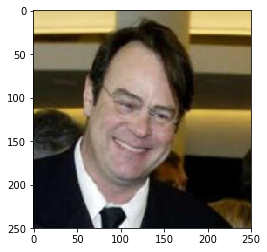

Human detected!
 The person most closely resembles a  Welsh springer spaniel


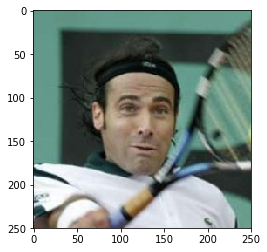

Human detected!
 The person most closely resembles a  Australian shepherd


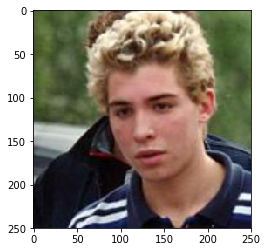

Dog detected!
 It looks like it is a  German pinscher


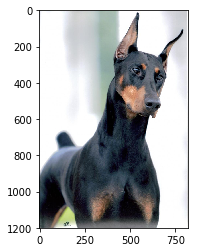

Dog detected!
 It looks like it is a  Doberman pinscher


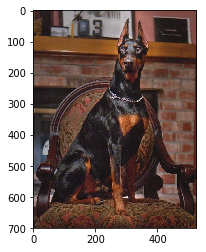

Dog detected!
 It looks like it is a  Doberman pinscher


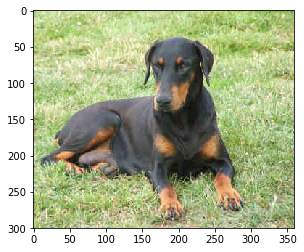

In [47]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

## suggested code, below
for file in np.hstack((human_files[:3], dog_files[100:103])): #6 images
    run_app(file)